In [35]:
import sklearn.linear_model as lm
from sklearn.linear_model import Ridge
from sklearn.linear_model import SGDRegressor
from sklearn.pipeline import make_pipeline
from sklearn.preprocessing import StandardScaler
from sklearn.ensemble import RandomForestClassifier, RandomForestRegressor
from sklearn.neural_network import MLPRegressor
import numpy as np
import math
import random

x = []
y = []

for line in open('data.txt'):
    xx, yy = map(float, line.strip().split())
    x.append(xx)
    y.append(yy)

features = []
for xx in x:
    curFeatures = [
        np.exp((xx)*2),                          # a^2
        (xx) ** (3/2),                             # b^2
        np.exp(xx) * ((xx) ** (3/4)),            # 2ab
        np.cos(xx) ** 2                          # c
    ]
    features.append(curFeatures)

#linearModel = lm.LinearRegression()
#linearModel = lm.Lasso(alpha = 1.0)
#reg = make_pipeline(StandardScaler(), SGDRegressor(max_iter=1000, tol=1e-3))
#linearModel = lm.RidgeCV()
#linearModel = lm.SGDRegressor(max_iter=1000, tol=1e-3)
#linearModel = lm.BayesianRidge()
#rf = RandomForestClassifier(n_estimators=100, max_depth=20, random_state=42)
#linearModel = rf
#linearModel = lm.ElasticNetCV()
#linearModel = MLPRegressor()
epsilon_values = [1.35, 1.5, 1.75, 1.9]
linearModel = lm.HuberRegressor(alpha=0.000000001, epsilon=1, fit_intercept = False)
linearModel.fit(features, y)

#x = np.linspace(min(features), max(features), 7)


#from sklearn import preprocessing
#X = preprocessing.StandardScaler().fit(features).transform(features)
#linearModel.fit(X, y)
coeffs = linearModel.coef_
#random.uniform(-0.001, 0.001)
a = math.sqrt(coeffs[0])
b = math.sqrt(coeffs[1])
c = coeffs[3]

print ("free coeff: ", linearModel.intercept_)
print ("2ab error: ", coeffs[2] - 2 * a * b)
print (a, b, c)

free coeff:  0.0
2ab error:  0.0013071431155111668
2.0900006963425137 20.199837094568338 -3.74937591564541


In [17]:
import numpy as np
import math
import pandas as pd
from sklearn.linear_model import LinearRegression
from sklearn.linear_model import RidgeCV
from sklearn.metrics import mean_absolute_error
import matplotlib.pyplot as plt

In [18]:
xy = np.loadtxt("data.txt")

In [19]:
x = xy[:,0]
y = xy[:,1]

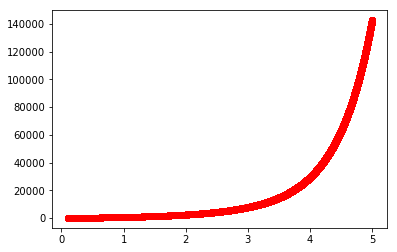

In [20]:

plt.plot(x, y, 'ro')
plt.show()


In [21]:
feat = np.stack([np.exp((x)*2), np.exp(x) * ((x) ** (3/4)), (x) ** (3/2), np.cos(x) ** 2], axis=1)

In [22]:
feat.shape

(100000, 4)

In [23]:
lr = LinearRegression(fit_intercept=True)

In [24]:
lr.fit(feat, y)

LinearRegression()

In [10]:


mean_absolute_error(lr.predict(feat), y)



6.898911956806201

In [29]:
lr.coef_

array([  4.36804105,  84.43902649, 408.00709587,  -3.79485467])

In [30]:
a = np.sqrt(lr.coef_[0])
b = np.sqrt(lr.coef_[2])
c = lr.coef_[3]

In [33]:
round(a, 3), round(b, 3), round(c, 3)

(2.09, 20.199, -3.795)

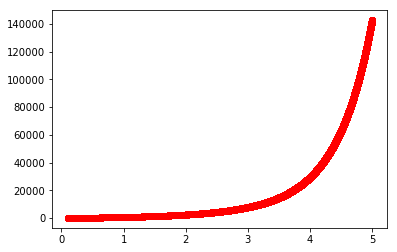

In [16]:


plt.plot(x, lr.predict(feat), 'ro')
plt.show()

